# Variational Autoencoder to reconstruct (and generate new) images from latent space
# Resolution of the reconstructed images is 256x256

# Manipulated latent vector values to generate new images with variation

# 20 cat images and 20 dog images (both repeated 5 times) and split as 
# training and validation data

# Loss(MSE) has been reduced to less than 0.00026 for reconstructed images

# Original and Reconstructed (with no changes to latent variables) or  Generated (with changes to latent variables) images plotted side-by-side 
# Image to image transitions such as cat to dog, dog to cat, colored to  black, white to colored, cat to human and other transitions demostrated (plotted) 
# Several new images plotted to show the noise, blurriness and faded color in generated images with respect to mean and standard deviation.

In [43]:
################################################################################################################################
# Import all required modules backend, layers, optim, callbacks, img-to-array, load-img,load-model etc.
################################################################################################################################
import numpy as np
import tensorflow as tf
from tensorflow.keras import backend as K
from tensorflow.keras.layers import BatchNormalization, Conv2D, Conv2DTranspose, LeakyReLU, Activation, Flatten, Dense, Reshape
from tensorflow.keras.layers import Input, Lambda
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras import callbacks
from tensorflow.keras.callbacks import ReduceLROnPlateau, ModelCheckpoint
from tensorflow.keras.preprocessing.image import img_to_array
from tensorflow.keras.preprocessing.image import load_img
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import load_model 
from imutils import paths
import os
import matplotlib.pyplot as plt
import cv2
import warnings
warnings.filterwarnings('ignore')
import tensorflow_addons as tfa
import tqdm
tqdm_callback = tfa.callbacks.TQDMProgressBar()
import pandas as pd
import seaborn as sns

In [4]:
################################################################################################################################
# define the convolutional autoencoder model with encoder, decoder and latent dimention of 2
# initialize the input shape to be "channels last" along with the channels dimension 
# flatten the network and then construct our latent vector
# build the decoder model which will accept the
# output of the encoder as its inputs
# loop over our number of filters again, but this time in
# reverse order
# at the end apply a single CONV_TRANSPOSE layer used to recover the original depth of the image
# our autoencoder is the encoder + decoder
# return a 3-tuple of the encoder, decoder, and autoencoder
################################################################################################################################
class ConvAutoencoder:
    @staticmethod
    def build(width, height, depth, filters=(32, 64, 128), latentDim=2):  
        inputShape = (height, width, depth)
        global chanDim 
        chanDim = -1
        inputs = Input(shape=inputShape)
        x = inputs
        for f in filters:
            x = Conv2D(f, (3, 3), strides=2, padding="same")(x)
            x = LeakyReLU(alpha=0.2)(x)
            x = BatchNormalization(axis=chanDim)(x)
        global volumeSize 
        volumeSize = K.int_shape(x)
        x = Flatten()(x)
        latent = Dense(latentDim)(x)
        encoder = Model(inputs, latent, name="encoder")
    
           
        latentInputs = Input(shape=(latentDim,))
        x = Dense(np.prod(volumeSize[1:]))(latentInputs)
        x = Reshape((volumeSize[1], volumeSize[2], volumeSize[3]))(x)
        for f in filters[::-1]:
            x = Conv2DTranspose(f, (3, 3), strides=2, padding="same")(x)
            x = LeakyReLU(alpha=0.2)(x)
            x = BatchNormalization(axis=chanDim)(x)

    
        x = Conv2DTranspose(depth, (3, 3), padding="same")(x)
        outputs = Activation("sigmoid")(x)

        decoder = Model(latentInputs, outputs, name="decoder")
        
    
        autoencoder = Model(inputs, decoder(encoder(inputs)), name="autoencoder")

        
        return (encoder, decoder, autoencoder)

In [5]:
################################################################################################################################
#  load the cat and dog images, preprocess them and store in 2 separate list    
################################################################################################################################
data = []
filenames = []
path='./dataset/images/'
imagePaths = list(paths.list_images(path))
for (i, imagePath) in enumerate(imagePaths):
    filename = imagePath
    image = cv2.imread(imagePath)
    image = load_img(imagePath, target_size=(256, 256))
    image = img_to_array(image)
    data.append(image)
    filenames.append(filename)
len(data),len(filenames)

(200, 200)

In [6]:
################################################################################################################################
# convert the data into NumPy arrays and scaling the
# pixel intensities from the range [0, 255] to [0, 1]    
################################################################################################################################
data = np.array(data, dtype="float32") / 255.0

In [7]:
################################################################################################################################
# remove the word copy from  filenames so that we can balance the train and test files evenly 
################################################################################################################################
for i in range(len(filenames)):
    
    filenames[i]=str(filenames[i]).replace(' - Copy (4)','')
    filenames[i]=str(filenames[i]).replace(' - Copy (3)','')
    filenames[i]=str(filenames[i]).replace(' - Copy (2)','')
    filenames[i]=str(filenames[i]).replace(' - Copy (1)','')
    filenames[i]=str(filenames[i]).replace(' - Copy','')
 

In [8]:
################################################################################################################################
# partition the data into training and testing by spliting using 80% of
# the data for training and the remaining 20% for testing     
################################################################################################################################

trainImages, testImages, trainFilenames, testFilenames = train_test_split(data, filenames, test_size=0.20,stratify=filenames\
                                                                          ,random_state=1)
len(trainImages), len(testImages), len(trainFilenames), len(testFilenames)

(160, 40, 160, 40)

In [9]:
################################################################################################################################
# write the testing filenames to disk so that we can use then
# when evaluating/testing 
################################################################################################################################

TEST_FILENAMES='./output/test_images.txt'

f = open(TEST_FILENAMES, "w")
f.write("\n".join(testFilenames))
f.close()


In [10]:
################################################################################################################################
# construct our convolutional autoencoder nd load it with previously trained weights     
################################################################################################################################

(encoder, decoder, autoencoder) = ConvAutoencoder.build(256, 256, 3)


In [11]:
autoencoder.summary()

Model: "autoencoder"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 256, 256, 3)]     0         
_________________________________________________________________
encoder (Functional)         (None, 2)                 356290    
_________________________________________________________________
decoder (Functional)         (None, 256, 256, 3)       634819    
Total params: 991,109
Trainable params: 990,213
Non-trainable params: 896
_________________________________________________________________


In [12]:
encoder.summary()

Model: "encoder"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 256, 256, 3)]     0         
_________________________________________________________________
conv2d (Conv2D)              (None, 128, 128, 32)      896       
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 128, 128, 32)      0         
_________________________________________________________________
batch_normalization (BatchNo (None, 128, 128, 32)      128       
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 64, 64, 64)        18496     
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 64, 64, 64)        0         
_________________________________________________________________
batch_normalization_1 (Batch (None, 64, 64, 64)        256 

In [13]:
decoder.summary()

Model: "decoder"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 2)]               0         
_________________________________________________________________
dense_1 (Dense)              (None, 131072)            393216    
_________________________________________________________________
reshape (Reshape)            (None, 32, 32, 128)       0         
_________________________________________________________________
conv2d_transpose (Conv2DTran (None, 64, 64, 128)       147584    
_________________________________________________________________
leaky_re_lu_3 (LeakyReLU)    (None, 64, 64, 128)       0         
_________________________________________________________________
batch_normalization_3 (Batch (None, 64, 64, 128)       512       
_________________________________________________________________
conv2d_transpose_1 (Conv2DTr (None, 128, 128, 64)      7379

In [14]:
################################################################################################################################
#  define callbacks, reduce lr on plateau,checkpoints and weights filepath 
################################################################################################################################

RLROP_PAT = 15
DECAY_DROP = .95

FILEPATHA="./Weights/weights_autoencoder.hdf5"
Reduce_lr_on_plat=ReduceLROnPlateau(monitor='val_loss',mode='min', patience=RLROP_PAT,factor=DECAY_DROP,min_lr=1e-15,verbose=1)
checkpoint = ModelCheckpoint(FILEPATHA, monitor='val_loss', verbose=1, save_best_only=True, mode='min')

callback = [tqdm_callback,checkpoint,Reduce_lr_on_plat]

In [15]:
################################################################################################################################
# load the trained model from the above path.
################################################################################################################################

autoencoder = load_model(FILEPATHA) 

In [16]:
################################################################################################################################
# define optimizer , loss function and compile the model     
################################################################################################################################

opt = Adam(lr=9.0e-05, beta_1=0.9)                                        #9.0e-05 to get to .00026
autoencoder.compile(loss="mse", optimizer=opt)

In [45]:
################################################################################################################################
# train the convolutional autoencoder for small number of epochs as it is alraedy trained
################################################################################################################################

EPOCHS = 15
Batch_Size = 20
History = autoencoder.fit(trainImages, trainImages,validation_data=(testImages, testImages),epochs=EPOCHS,callbacks=callback,
                    batch_size=Batch_Size,verbose=0)

Training:   0%|                                                                                0/15 ETA: ?s,  …

Epoch 1/15


0/8                                                                                                          E…


Epoch 00001: val_loss did not improve from 0.00025
Epoch 2/15


0/8                                                                                                          E…


Epoch 00002: val_loss did not improve from 0.00025
Epoch 3/15


0/8                                                                                                          E…


Epoch 00003: val_loss did not improve from 0.00025
Epoch 4/15


0/8                                                                                                          E…


Epoch 00004: val_loss improved from 0.00025 to 0.00025, saving model to ./Weights\weights_autoencoder.hdf5
Epoch 5/15


0/8                                                                                                          E…


Epoch 00005: val_loss did not improve from 0.00025
Epoch 6/15


0/8                                                                                                          E…


Epoch 00006: val_loss did not improve from 0.00025

Epoch 00006: ReduceLROnPlateau reducing learning rate to 8.550000129616819e-05.
Epoch 7/15


0/8                                                                                                          E…


Epoch 00007: val_loss improved from 0.00025 to 0.00025, saving model to ./Weights\weights_autoencoder.hdf5
Epoch 8/15


0/8                                                                                                          E…


Epoch 00008: val_loss did not improve from 0.00025
Epoch 9/15


0/8                                                                                                          E…


Epoch 00009: val_loss did not improve from 0.00025
Epoch 10/15


0/8                                                                                                          E…


Epoch 00010: val_loss did not improve from 0.00025
Epoch 11/15


0/8                                                                                                          E…


Epoch 00011: val_loss improved from 0.00025 to 0.00025, saving model to ./Weights\weights_autoencoder.hdf5

Epoch 00011: ReduceLROnPlateau reducing learning rate to 8.12250033050077e-05.
Epoch 12/15


0/8                                                                                                          E…


Epoch 00012: val_loss did not improve from 0.00025
Epoch 13/15


0/8                                                                                                          E…


Epoch 00013: val_loss did not improve from 0.00025
Epoch 14/15


0/8                                                                                                          E…


Epoch 00014: val_loss did not improve from 0.00025
Epoch 15/15


0/8                                                                                                          E…


Epoch 00015: val_loss did not improve from 0.00025


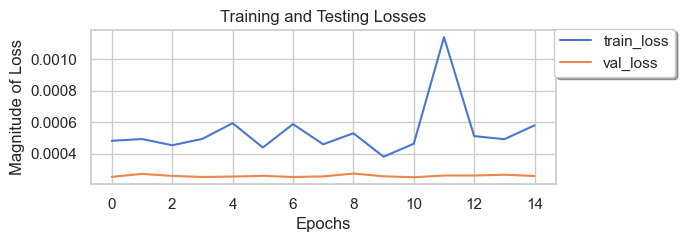

In [46]:
################################################################################################################################
#  plot the loss values of training and validation obtained while training    
################################################################################################################################
sns.set(style='whitegrid', palette='muted', font_scale=1.0)
plt.figure(figsize=(6,2))
plt.plot(History.history["loss"],     label="train_loss")
plt.plot(History.history["val_loss"], label="val_loss")
plt.title("Training and Testing Losses")
plt.xlabel("Epochs")
plt.ylabel("Magnitude of Loss")
plt.legend(bbox_to_anchor=(0.773, 0.56, 0.5, 0.5),shadow=True)
plt.show()

# Original and Reconstructed(Generated) images of Variational Autoencoder 

In [17]:
################################################################################################################################
#  extract encoder and decoders from the autoencoder to call them separetly 
################################################################################################################################

encoder= autoencoder.get_layer('encoder')
decoder= autoencoder.get_layer('decoder')
encoded = encoder.predict(testImages)

In [18]:
################################################################################################################################
#  check the shape of the encoded      
################################################################################################################################

encoded.shape

(40, 32)

In [19]:
################################################################################################################################
#  define a module to change the latent vector by a given percentage     
################################################################################################################################

def modify_latent_variables_by_given_percent(percent=0):
    changed_encoded = np.empty((40,32),dtype='float32',like=encoded)
    for i in range(40):
        for j in range(32):
            a=encoded[i,j]
            if a>0:
                a = a*((percent+100)/100)
            else:
                a = a*((100-percent)/100)
            changed_encoded[i,j]=a

    return changed_encoded

In [20]:
################################################################################################################################
#  Define a module to print the generated images with given percentage changes.
#  if the percentgae change is 0, then they are the reconstructed images
#  Resolution of reconstructed images is 256x256     
################################################################################################################################
def viz_images_with_percent_change(alt=True,percent=0):
    encodedC=modify_latent_variables_by_given_percent(percent)
    decodedC=decoder.predict(encodedC)
    a=0
    for i in range(int(len(testImages)/6)):
        plt.figure(figsize=(16,30))
        for j in range(3):
            if alt==True:
                a+=2
            else:
                a+=1
            if ((i == 0) & (j==2)):
                if percent==0:
                    plt.title("Original(left) and Reconstructed(right) Images \nwith no changes to model generated latent vector",\
                              fontsize=25,va='bottom',color='#555511',fontweight='bold')
                else:
                    plt.title("Original(left) and Generated(right) with "+str(percent)+" percent changes to latent vector",\
                              fontsize=25,va='bottom',color='#555511',fontweight='bold')
            original_images      = (testImages[a] * 255).astype("uint8")
            reconstructed_images = (decodedC[a] * 255).astype("uint8")
            output = np.hstack([original_images, reconstructed_images])
            plt.subplot2grid((6,3),(i,j),1,1)
            plt.imshow(output, aspect=1) 
            plt.axis('off')
        plt.tight_layout()
        plt.show()
    plt.show()

# quality of reconstructed images is as good as the original images 

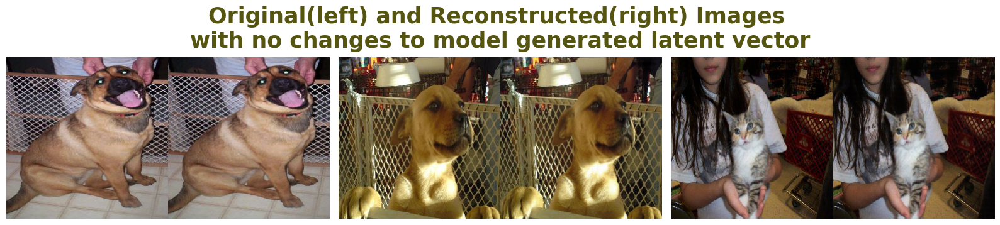

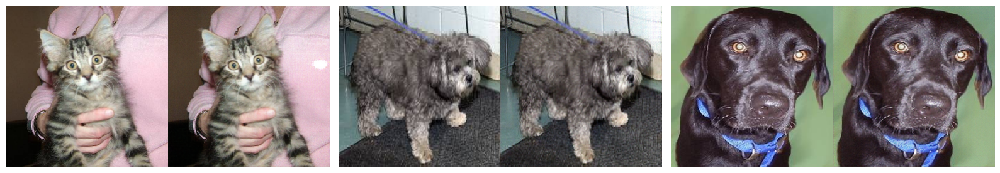

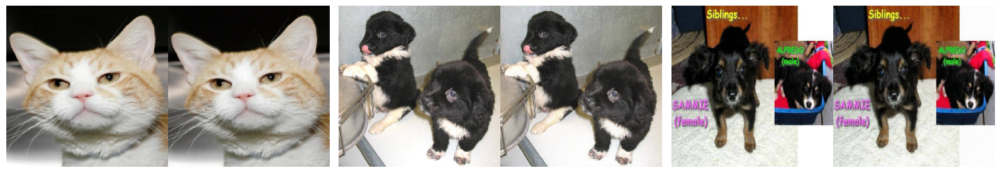

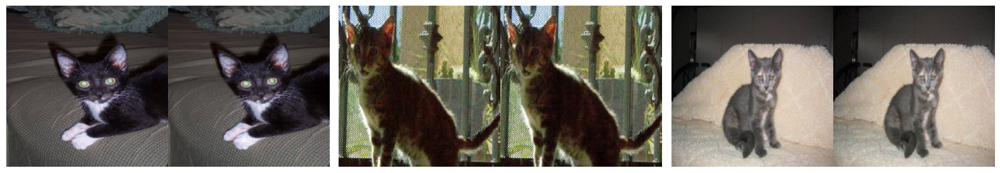

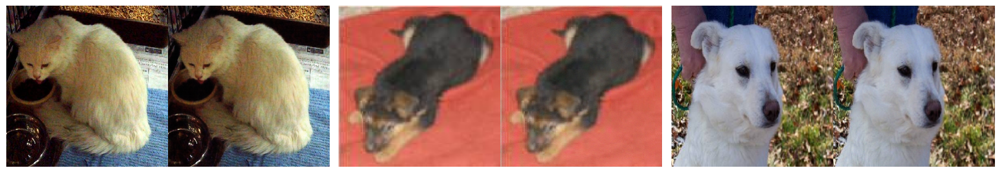

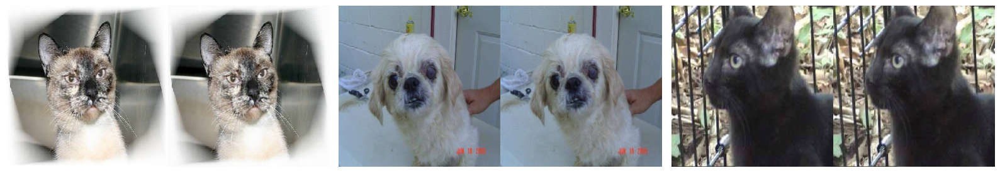

In [21]:
viz_images_with_percent_change(0)

# quality of images drop a little with 25 percent changes to latent vector

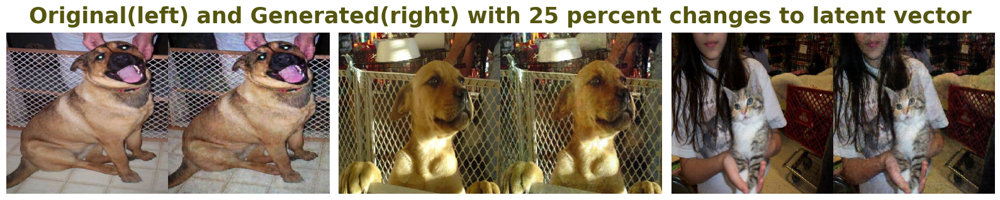

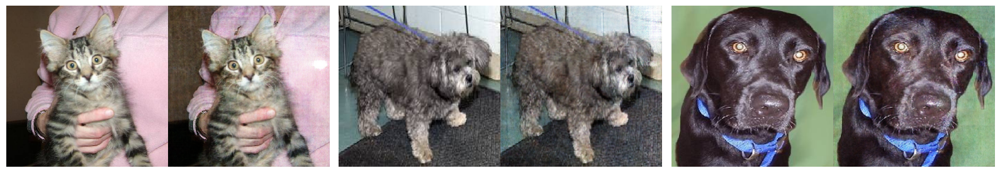

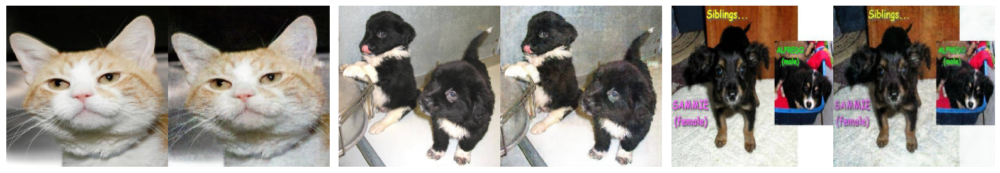

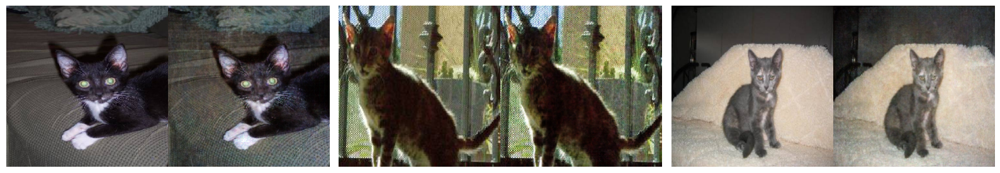

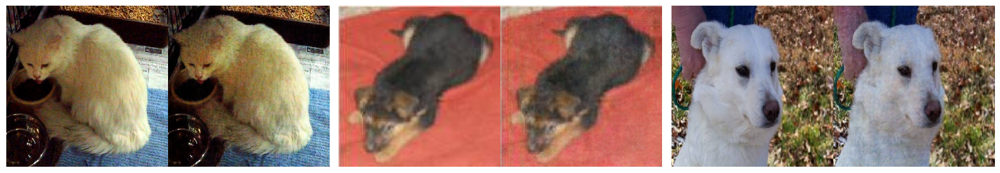

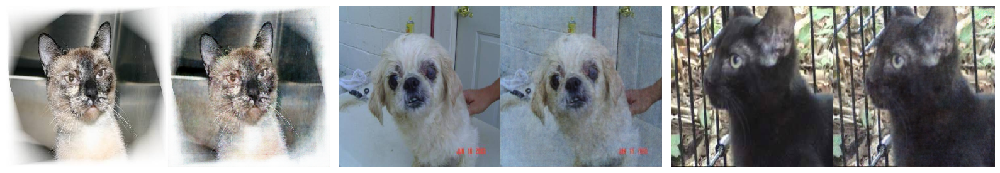

In [22]:
viz_images_with_percent_change(alt=False,percent=25)

# quality of images drop very much with 50 percent changes to latent vector

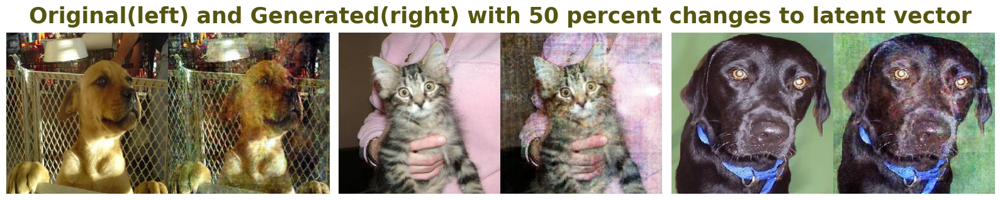

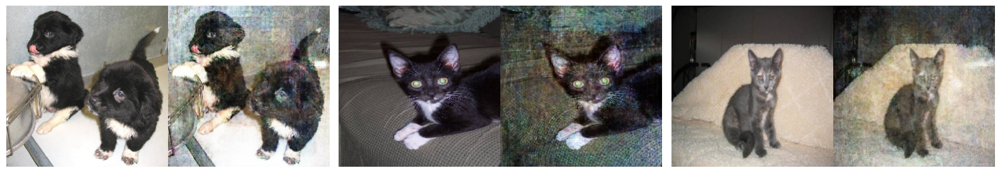

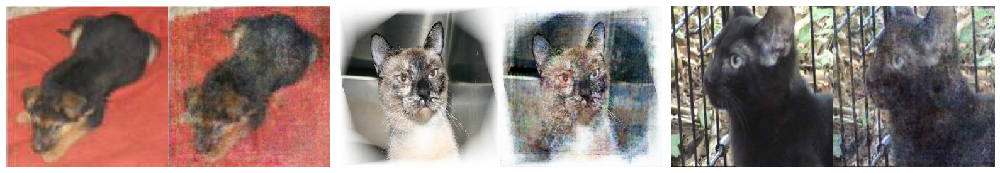

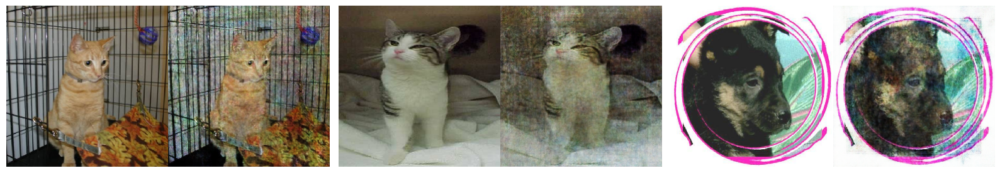

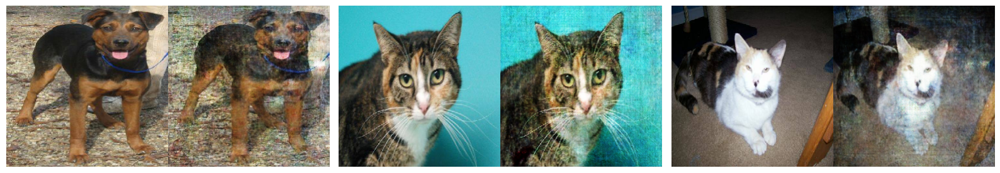

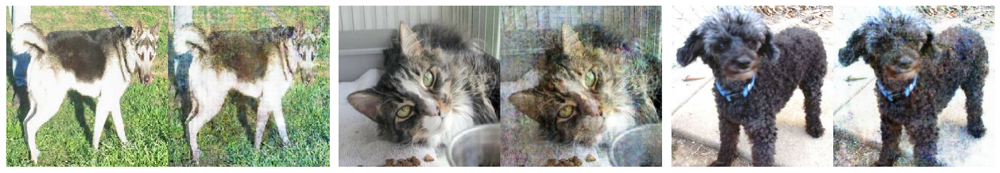

In [23]:
viz_images_with_percent_change(alt=True,percent=50)

# Variations of images with respect to mean and standard deviation 

In [24]:
################################################################################################################################
# load the trained weights with just 2 latent dimensions to hold std and mean values of input distributons
################################################################################################################################
FILEPATHB="./Weights/weights_autoencoder_latent2.hdf5"
autoencoder = load_model(FILEPATHB) 

In [25]:
################################################################################################################################
# extract the encoder and decoder from the loaded model 
################################################################################################################################

encoder= autoencoder.get_layer('encoder')
decoder= autoencoder.get_layer('decoder')

In [26]:
################################################################################################################################
# encode the testfile images 
################################################################################################################################

encoded = encoder.predict(testImages)

In [27]:
################################################################################################################################
# label encode the testfile image names 
################################################################################################################################
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
testFilenames_coded = le.fit_transform(testFilenames)
testFilenames_coded

array([14, 38, 35, 15, 10, 30, 31,  8, 23, 29, 17,  4, 16, 13, 24, 21, 19,
       37, 12,  6,  3, 32,  2, 22, 28,  7, 20, 36,  0, 18,  1, 11, 27, 25,
        9, 39, 26, 33, 34,  5], dtype=int64)

In [28]:
################################################################################################################################
# check the shape of the encoded data 
################################################################################################################################

encoded.shape

(40, 2)

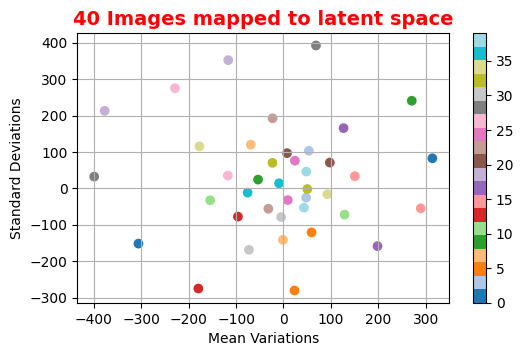

In [29]:
################################################################################################################################
# define a module to visualize the latent space with respect to fifferent input data/image files 
################################################################################################################################

def viz_latent_space(encoder, data):
      input_data, target_data = data
      mu = encoder.predict(input_data)
      plt.figure(figsize=(6, 3.5))
      plt.scatter(mu[:, 0], mu[:, 1], c=target_data, cmap='tab20')
      plt.xlabel('Mean Variations')
      plt.ylabel('Standard Deviations')
      plt.title('40 Images mapped to latent space',color='red',fontweight='bold',fontsize='14')
      plt.colorbar()
      plt.grid(True)
      plt.show()

data = (testImages, testFilenames_coded)
viz_latent_space(encoder, data)

In [32]:
################################################################################################################################
# define a module to visualize images with changes to mean and standard deviations 
################################################################################################################################

def viz_variations(decoder, data,mux1=-1,mux2=1,muy1=-1,muy2=1,num_samples = 4):
      img_width=256; img_height=256 ; num_channels=3
      figure = np.empty((img_width * num_samples, img_height * num_samples, num_channels))
      grid_x = np.linspace(mux2, mux1,  num_samples)[::-1]
      grid_y = np.linspace(muy1, muy2, num_samples)
      for i, yi in enumerate(grid_y):
          for j, xi in enumerate(grid_x):
              z_sample = np.array([[xi, yi]])
              x_decoded = decoder.predict(z_sample)
              img = x_decoded[0].reshape(img_width, img_height, num_channels)
              figure[i * img_width:  (i + 1) * img_width, j * img_height: (j + 1) * img_height] = img
      plt.figure(figsize=(5.6, 5.6))
      start_range = img_width // 2
      end_range = num_samples * img_width + start_range 
      pixel_range = np.arange(start_range, end_range, img_width)
      sample_range_x = np.round(grid_x, 1)
      sample_range_y = np.round(grid_y, 1)
      plt.xticks(pixel_range, sample_range_x)
      plt.yticks(pixel_range, sample_range_y)
      plt.xlabel('Mean Variations')
      plt.ylabel('Standard Deviations')
      fig_shape = np.shape(figure)
      if fig_shape[2] == 1:
        figure = figure.reshape((fig_shape[0], fig_shape[1])) 
      plt.imshow(figure)
      plt.show()

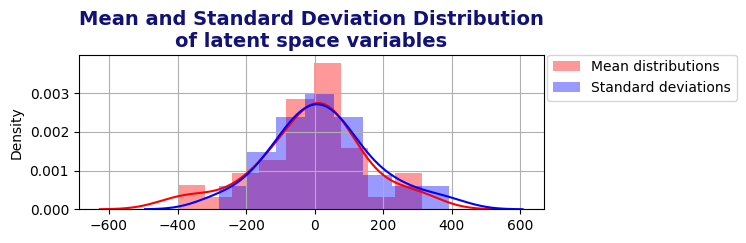

In [33]:
################################################################################################################################
# plot the distributions of mean and standard deviations of input data 
################################################################################################################################

plt.figure(figsize=(6,2))
sns.distplot(encoded[:,0],color='red',kde=True,label='Mean distributions')
sns.distplot(encoded[:,1],color='blue',kde=True,label='Standard deviations')
plt.title('Mean and Standard Deviation Distribution\nof latent space variables',color='#111177',fontweight='bold',fontsize='14')
plt.legend(bbox_to_anchor=(0.93, 0.55, 0.5, 0.5))
plt.grid(True)
plt.show()

# Plotting variations of original images by manipulating latent variables w.r.t mean and standard deviation;
# images at the top left corner are original and bottom right corner are with maximum Mean and Standard deviation from the original image distributions.
# As the image deviates from the original image in terms of mean and standard deviation, images get blurry, noisy and fade.

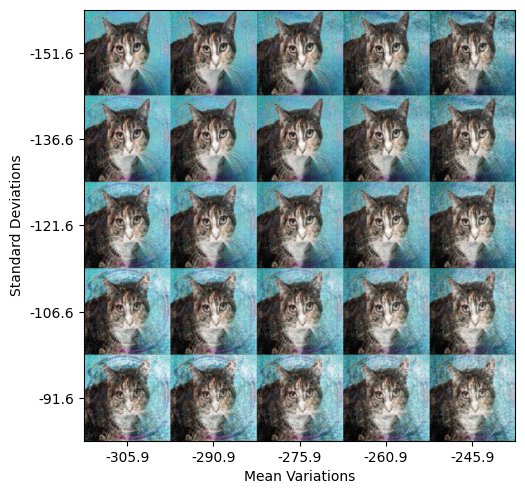

In [34]:
################################################################################################################################
# Cat with blue background variations
################################################################################################################################
viz_variations(decoder, data, -305.880554, -245.880554, -151.596283,  -91.596283,5)

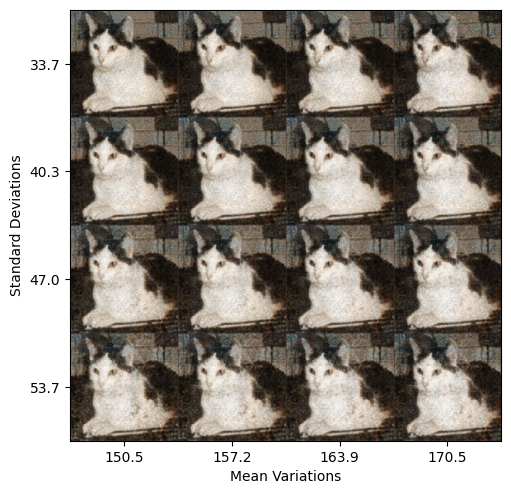

In [35]:
################################################################################################################################
# white cat variations
################################################################################################################################
viz_variations(decoder, data, 150.547363, 170.547363, 33.674408,  53.674408,4)

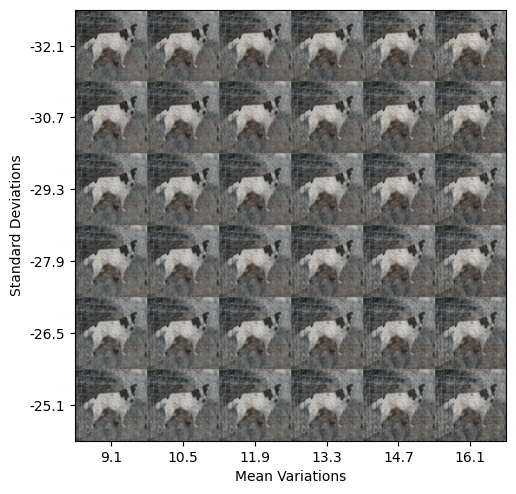

In [36]:
################################################################################################################################
# white&black dog variations
################################################################################################################################
viz_variations(decoder, data, 9.146467, 16.146467, -32.084652,  -25.084652,6)

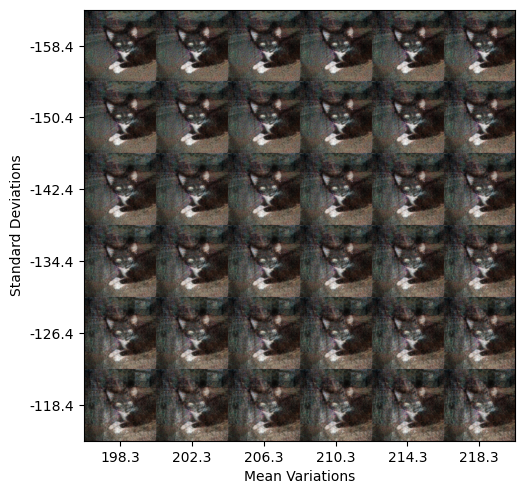

In [37]:
################################################################################################################################
# black cat variations
################################################################################################################################
viz_variations(decoder, data, 198.320847, 218.320847, -158.448669,  -118.448669,6)

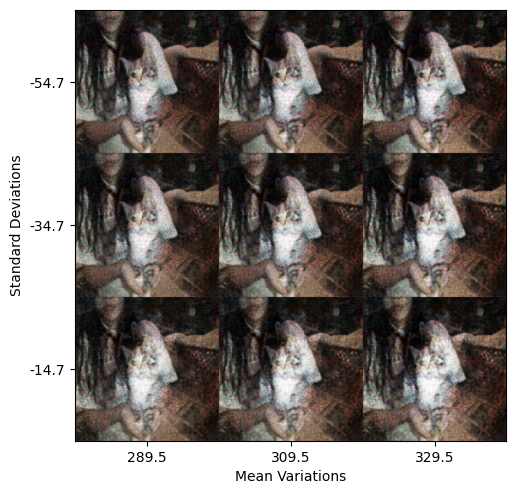

In [38]:
################################################################################################################################
# human and cat variations
################################################################################################################################
viz_variations(decoder, data, 289.491425, 329.491425, -54.653923,  -14.653923,3)

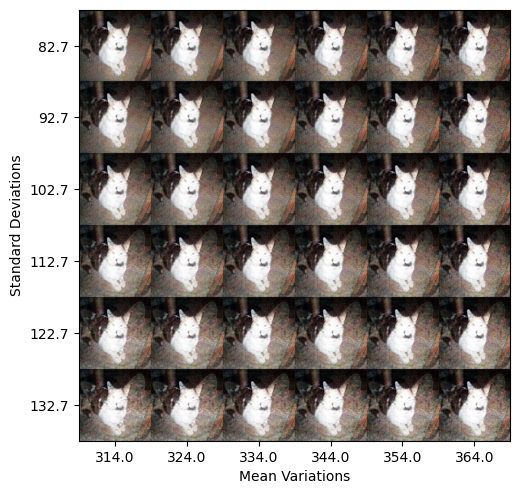

In [39]:
################################################################################################################################
# white cat variations
################################################################################################################################
viz_variations(decoder, data, 314.002655, 364.002655, 82.691467,  132.691467,6)

# Image to Image transition. Top left and bottom right are original images.

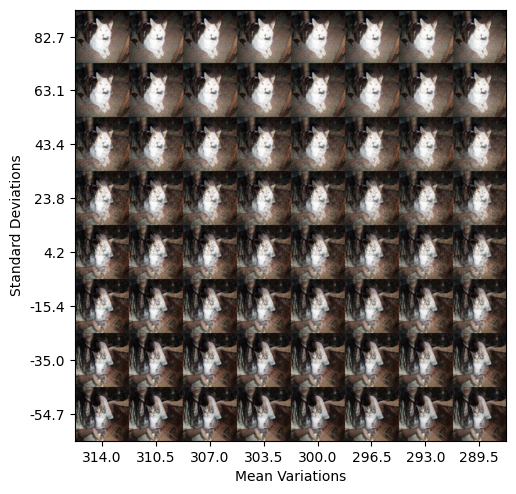

In [40]:
################################################################################################################################
# white cat to human transition
################################################################################################################################
viz_variations(decoder, data, 314.002655, 289.491425, 82.691467,  -54.653923,8)

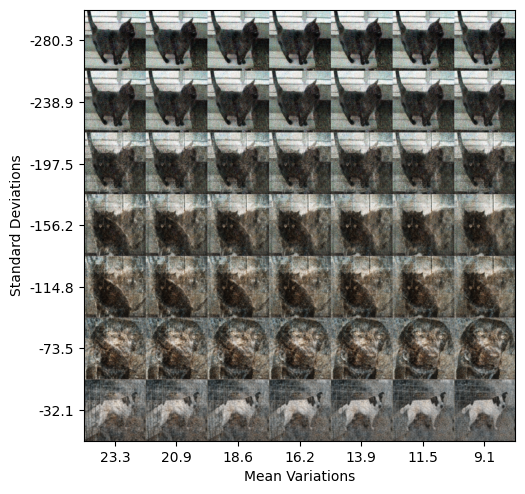

In [41]:
################################################################################################################################
# black cat to white&black dog transition
################################################################################################################################
viz_variations(decoder, data, 23.286837, 9.146467, -280.281555,  -32.084652,7)

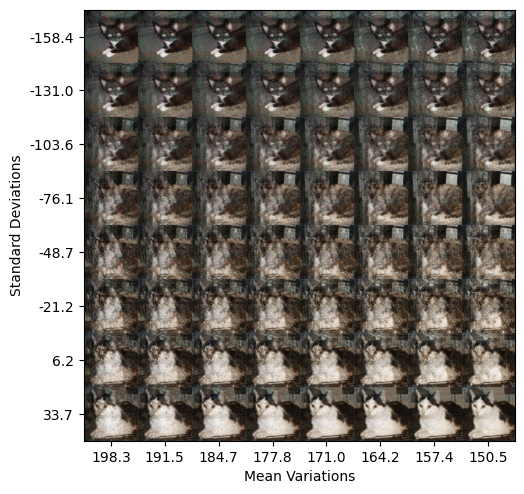

In [42]:
################################################################################################################################
# black cat to white cat transition
################################################################################################################################
viz_variations(decoder, data, 198.320847, 150.547363, -158.448669,  33.674408,8)